In [1]:
import pandas as pd
import read_results
from utils import PathLocator
import plot
from matplotlib import pyplot as plt
import seaborn as sns
from plot.ranker import Ranker
import itertools

/home/jarevalo/mambaforge/envs/bcorrect/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
2023-07-03 16:39:41.214699: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-07-03 16:39:41.265640: I tensorflow/core/util/port.cc:104] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.


# Scenario 1
## Batch embeddings

In [2]:
output_path = './outputs/scenario_1/'
all_locators = read_results.find_all_locators(output_path)
locators = [loc for loc in all_locators if loc.model == 'sphering']
embds = plot.embeddings.load_embeddings(locators)
redlist = ['percent_repl', 'wasserstein_distance', 'fraction_positive_p', 'PCR_batch']

model_scores = read_results.load_from_locators(locators, redlist=redlist)
# Find metrics with low coefficient of variation
m = model_scores.groupby('metric')['score'].agg(['std', 'mean'])
m['cvar'] = m['std'] / m['mean']
lowcvar_metrics = m.fillna(0).sort_values('cvar')[lambda df: df['cvar']<0.01].index.tolist()

ranker = Ranker(model_scores[~model_scores['metric'].isin(lowcvar_metrics)], sortby_l2=False)

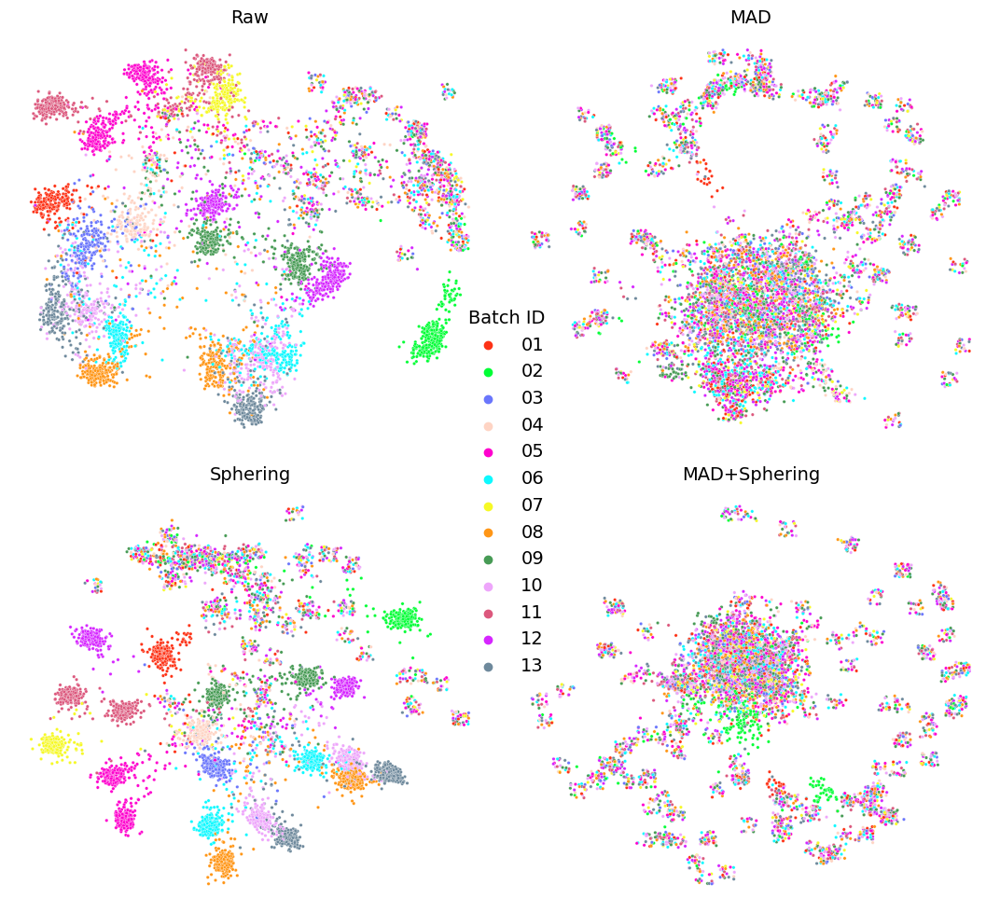

In [3]:
plt.rcParams.update({'font.size': 14})
g = sns.relplot(
    data=embds.sample(frac=1), # Shuffle
    x="x",
    y="y",
    hue="Batch",
    hue_order=embds.Batch.drop_duplicates().sort_values(),
    kind="scatter",
    col="model",
    col_order= ['Raw', 'MAD', 'Sphering', 'MAD+Sphering'],
    s=6,
    col_wrap=2,
    palette=plot.BATCH_CMAP,
)

#hide axis
g.set(xticks=[], yticks=[])
g.set(xlabel="", ylabel="")
sns.despine(left=True, right=True, top=True, bottom=True)

# Center legend
leg = g._legend
leg.set_bbox_to_anchor([0.55, 0.45])
leg.set_title('Batch ID')

g.set_titles("{col_name}")
plt.tight_layout()
plt.show()

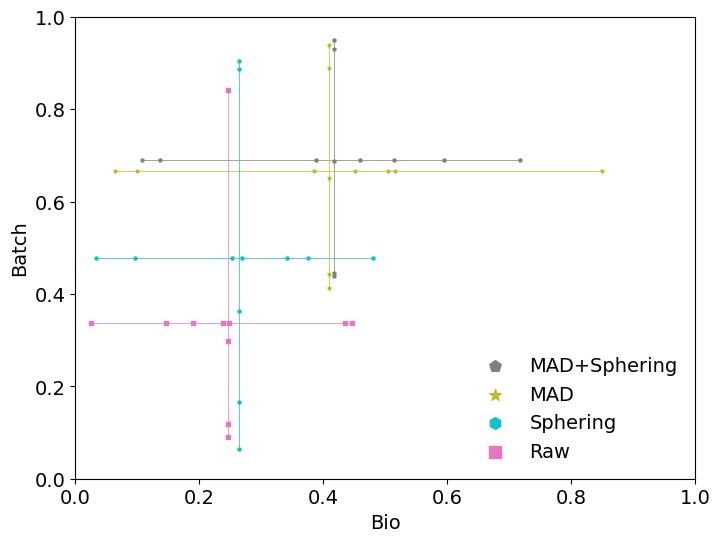

In [4]:
plt.rcParams.update({'font.size': 14})

fig, ax = plt.subplots(figsize=(8,6))
ax.set_xlim([0, 1])
ax.set_ylim([0, 1])

lines = ranker.rank.groupby('model')[['x', 'y']].describe()
lines = lines.loc[ranker.ranklist]
for model, row in lines.iterrows():
    ax.plot([row.x['min'], row.x['max']], [row.y['mean'], row.y['mean']],
            color=plot.METHOD_CMAP[model],
            linewidth=0.5
           )
    ax.plot([row.x['mean'], row.x['mean']], [row.y['min'], row.y['max']],
            color=plot.METHOD_CMAP[model],
            linewidth=0.5
           )
    ax.scatter(
        ranker.rank.query('model==@model').x,
        ranker.rank.query('model==@model').y,
        color=plot.METHOD_CMAP[model],
        marker=plot.METHOD_SMAP[model],
        s=6,
        label=model,
        )
ax.legend(frameon=False, markerscale=3.5, loc='lower right')
ax.set_ylabel('Batch')
ax.set_xlabel('Bio')
plt.show()

## Comparing multiple methods

In [5]:
all_locators = read_results.find_all_locators(output_path)
locators = [loc for loc in all_locators if loc.config['mad_norm'] and loc.config['sphering']]
# Make sure all embeddings come from the same config
assert len(set(loc.hashid for loc in locators)) == 1

embds = plot.embeddings.load_embeddings(locators)
model_scores = read_results.load_from_locators(locators, redlist=redlist)

embds.loc[embds['model']=='MAD+Sphering', 'model'] = 'Baseline'
model_scores.loc[model_scores['model']=='MAD+Sphering', 'model'] = 'Baseline'

# Find metrics with low coefficient of variation
m = model_scores.groupby('metric')['score'].agg(['std', 'mean'])
m['cvar'] = m['std'] / m['mean']
lowcvar_metrics = m.fillna(0).sort_values('cvar')[lambda df: df['cvar']<0.01].index.tolist()

ranker = Ranker(model_scores[~model_scores['metric'].isin(lowcvar_metrics)], sortby_l2=False)

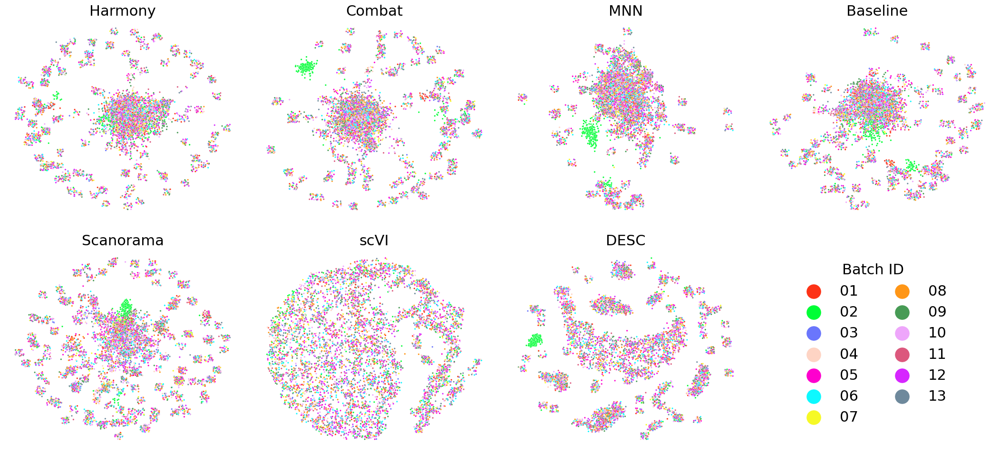

In [6]:
plt.rcParams.update({'font.size': 22})
g = sns.relplot(
    data=embds.sample(frac=1), # Shuffle
    x="x",
    y="y",
    hue="Batch",
    hue_order=embds.Batch.drop_duplicates().sort_values(),
    kind="scatter",
    col="model",
    col_order=ranker.ranklist,
    s=6,
    col_wrap=4,
    palette=plot.BATCH_CMAP,
)

#hide axis
g.set(xticks=[], yticks=[])
g.set(xlabel="", ylabel="")
sns.despine(left=True, right=True, top=True, bottom=True)

handles, labels = g.axes[0].get_legend_handles_labels()
g._legend.remove()
leg = g.fig.legend(handles, labels, ncol=2,
                   title='Batch ID', bbox_to_anchor=[0.95, 0.45],
                   frameon=False,
                   markerscale=3.5,
                  )

g.set_titles("{col_name}")
plt.tight_layout()
plt.show()

In [7]:
multiple_pos = embds.groupby('Compound')['Metadata_Well'].nunique()[lambda x: x>1].index
multiple_pos = embds[embds['Compound'].isin(multiple_pos)]

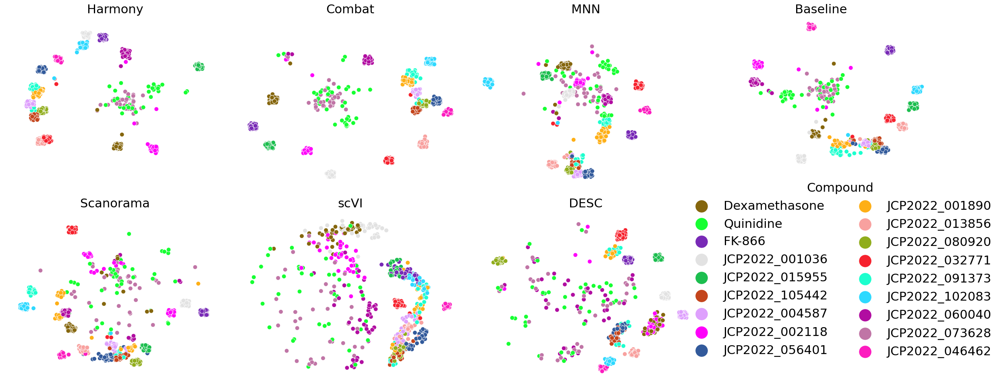

In [8]:
plt.rcParams.update({'font.size': 22})
compounds = multiple_pos.Compound.drop_duplicates().tolist()
non_poscons = [c for c in compounds if c not in plot.POSCONS]
poscons = [c for c in compounds if c in plot.POSCONS]
compound_order = poscons + non_poscons

compound_map = dict(zip(non_poscons, itertools.cycle(plot.COMPOUND_COLORS)))
compound_map.update(plot.POSCON_MAP)
g = sns.relplot(
    data=multiple_pos.sample(frac=1), # Shuffle
    x="x",
    y="y",
    hue="Compound",
    hue_order=compound_order,
    kind="scatter",
    col="model",
    col_order=ranker.ranklist,
    s=60,
    col_wrap=4,
    palette=compound_map,
)

#hide axis
g.set(xticks=[], yticks=[])
g.set(xlabel="", ylabel="")
sns.despine(left=True, right=True, top=True, bottom=True)

handles, labels = g.axes[0].get_legend_handles_labels()
g._legend.remove()
leg = g.fig.legend(handles, labels, ncol=2,
                   title='Compound', bbox_to_anchor=[1.06, 0.55], frameon=False,
                   markerscale=3.5,
                  )

g.set_titles("{col_name}")
plt.tight_layout()
plt.show()

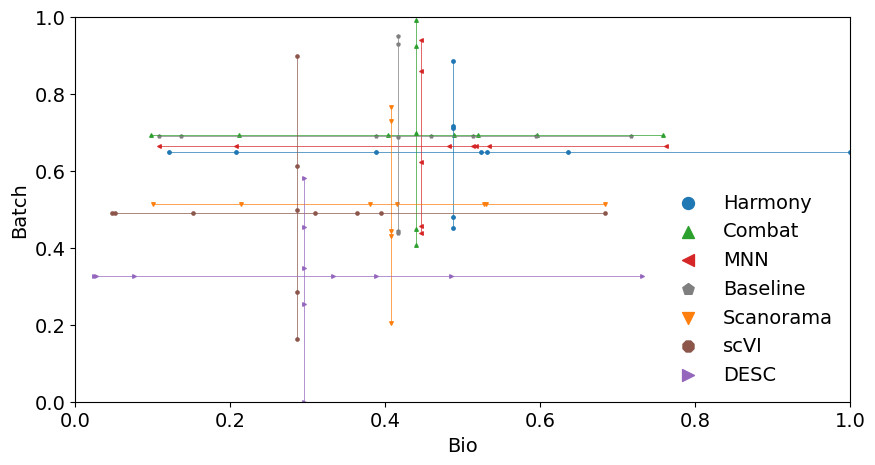

In [9]:
plt.rcParams.update({'font.size': 14})

fig, ax = plt.subplots(figsize=(10,5))
ax.set_xlim([0, 1])
ax.set_ylim([0, 1])

lines = ranker.rank.groupby('model')[['x', 'y']].describe()
lines = lines.loc[ranker.ranklist]
for model, row in lines.iterrows():
    ax.plot([row.x['min'], row.x['max']], [row.y['mean'], row.y['mean']],
            color=plot.METHOD_CMAP[model],
            linewidth=0.5
           )
    ax.plot([row.x['mean'], row.x['mean']], [row.y['min'], row.y['max']],
            color=plot.METHOD_CMAP[model],
            linewidth=0.5
           )
    ax.scatter(
        ranker.rank.query('model==@model').x,
        ranker.rank.query('model==@model').y,
        color=plot.METHOD_CMAP[model],
        marker=plot.METHOD_SMAP[model],
        s=6,
        label=model,
        )
ax.legend(frameon=False, markerscale=3.5,)
ax.set_ylabel('Batch')
ax.set_xlabel('Bio')
plt.show()

# Scenario 2

In [10]:
plate_types = ['TARGET2']
sources = ["source_2", "source_6", "source_10"]
output_path = './outputs/scenario_2/'
baseline = 'MAD+Sphering'

all_scores = read_results.load_all_results(output_path)
scores = all_scores[
    all_scores.sources.apply(lambda x: x==sources) &
    all_scores.plate_types.apply(lambda x:x==plate_types) &
    (all_scores.model==baseline) &
    (all_scores.min_replicates_to_eval==5)]

scores.loc[scores['model']=='MAD+Sphering', 'model'] = 'Baseline'

redlist = ['percent_repl', 'PCR_batch', 'wasserstein_distance', 'fraction_positive_p']
rank = plot.param_search.rank_scores(scores, redlist=redlist)
rank_pos = 0
locator = PathLocator(
    config_path=f'{output_path}/{rank.iloc[rank_pos].name}/config.json',
    model = 'sphering',
    min_replicates_to_eval=5,
    output_path=output_path
)

In [11]:
model_scores = read_results.load_same_conf(locator.config_path, 
                                           locator.min_replicates_to_eval,
                                           redlist=redlist,                                          
                                          )
model_scores.loc[model_scores['model']=='MAD+Sphering', 'model'] = 'Baseline'

# Ignore PCR_batch for mad+sphering because it is not a fair comparison
redlist_rows = (model_scores['model'] == baseline) & (model_scores['metric'] == 'PCR_batch')
model_scores = model_scores[~redlist_rows]

# Find metrics with low coefficient of variation
m = model_scores.groupby('metric')['score'].agg(['std', 'mean'])
m['cvar'] = m['std'] / m['mean']
lowcvar_metrics = m.fillna(0).sort_values('cvar')[lambda df: df['cvar']<0.01].index.tolist()

#build Rank
ranker = Ranker(model_scores[~model_scores['metric'].isin(lowcvar_metrics)])

embds = []
all_locators = read_results.find_all_locators(output_path)
locators = [loc for loc in all_locators if loc.hashid == locator.hashid]

embds = plot.embeddings.load_embeddings(locators, anon=True)
embds.loc[embds['model']=='MAD+Sphering', 'model'] = 'Baseline'


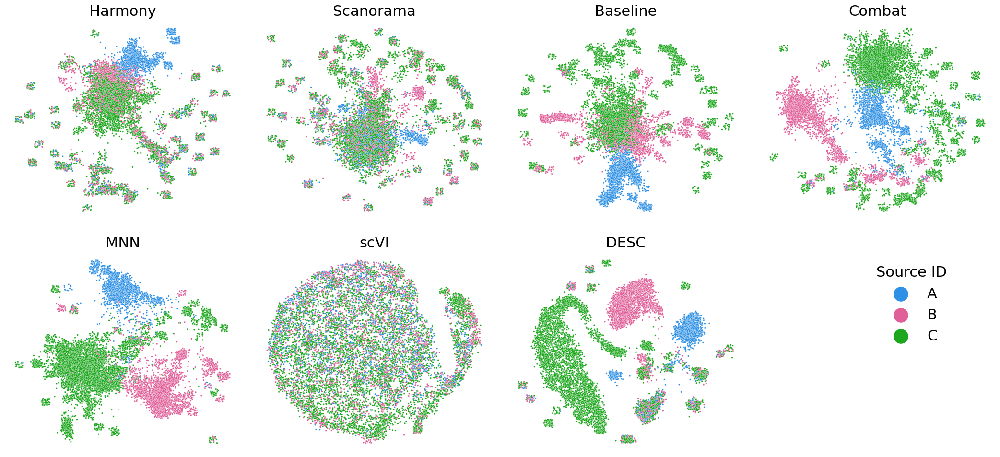

In [12]:
plt.rcParams.update({'font.size': 22})
g = sns.relplot(
    data=embds.sample(frac=1), # Shuffle
    x="x",
    y="y",
    hue="Source",
    hue_order=embds.Source.drop_duplicates().sort_values(),
    kind="scatter",
    col="model",
    col_order=ranker.ranklist,
    s=6,
    col_wrap=4,
    palette=plot.SOURCE_CMAP,
)

#hide axis
g.set(xticks=[], yticks=[])
g.set(xlabel="", ylabel="")
sns.despine(left=True, right=True, top=True, bottom=True)

handles, labels = g.axes[0].get_legend_handles_labels()
g._legend.remove()
leg = g.fig.legend(handles, labels,
                   title='Source ID', bbox_to_anchor=[0.95, 0.45],
                   frameon=False,
                   markerscale=3.5,
                  )

g.set_titles("{col_name}")
plt.tight_layout()
plt.show()

In [13]:
multiple_pos = embds.groupby('Compound')['Metadata_Well'].nunique()[lambda x: x>1].index
multiple_pos = embds[embds['Compound'].isin(multiple_pos)]

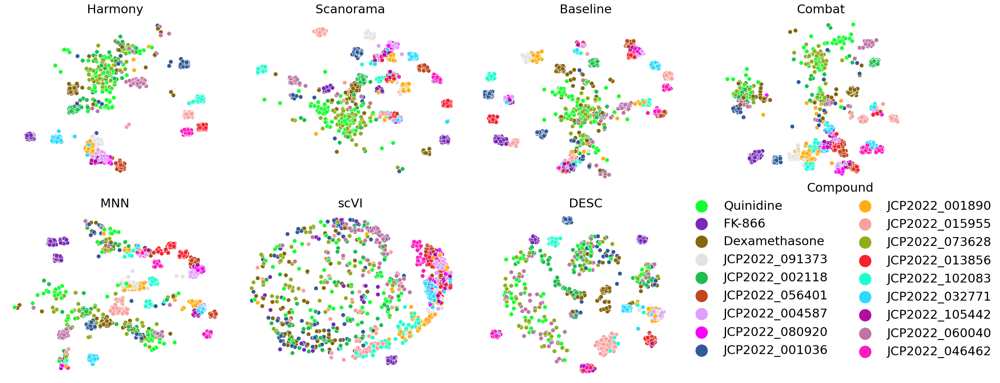

In [14]:
plt.rcParams.update({'font.size': 22})
compounds = multiple_pos.Compound.drop_duplicates().tolist()
non_poscons = [c for c in compounds if c not in plot.POSCONS]
poscons = [c for c in compounds if c in plot.POSCONS]
compound_order = poscons + non_poscons

compound_map = dict(zip(non_poscons, itertools.cycle(plot.COMPOUND_COLORS)))
compound_map.update(plot.POSCON_MAP)
g = sns.relplot(
    data=multiple_pos.sample(frac=1), # Shuffle
    x="x",
    y="y",
    hue="Compound",
    hue_order=compound_order,
    kind="scatter",
    col="model",
    col_order=ranker.ranklist,
    s=60,
    col_wrap=4,
    palette=compound_map,
)

#hide axis
g.set(xticks=[], yticks=[])
g.set(xlabel="", ylabel="")
sns.despine(left=True, right=True, top=True, bottom=True)

handles, labels = g.axes[0].get_legend_handles_labels()
g._legend.remove()
leg = g.fig.legend(handles, labels, ncol=2, 
                   title='Compound', bbox_to_anchor=[1.06, 0.55], frameon=False,
                   markerscale=3.5,
                  )

g.set_titles("{col_name}")
plt.tight_layout()
plt.show()

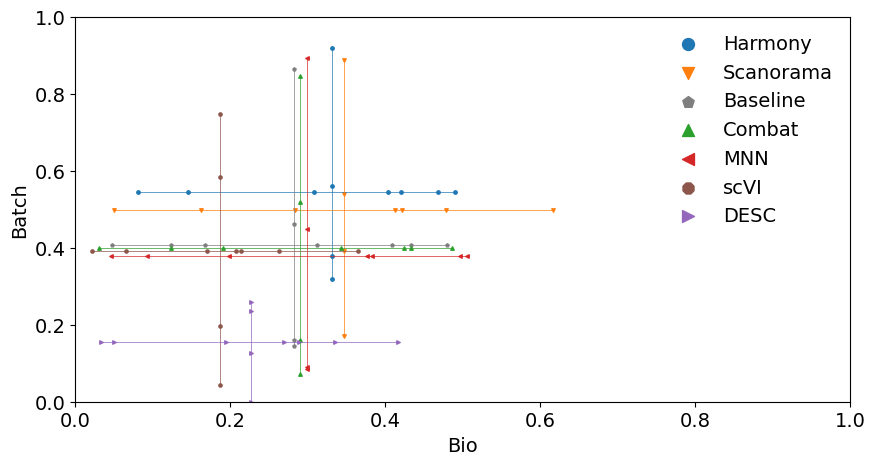

In [15]:
plt.rcParams.update({'font.size': 14})

fig, ax = plt.subplots(figsize=(10,5))
ax.set_xlim([0, 1])
ax.set_ylim([0, 1])

lines = ranker.rank.groupby('model')[['x', 'y']].describe()
lines = lines.loc[ranker.ranklist]
for model, row in lines.iterrows():
    ax.plot([row.x['min'], row.x['max']], [row.y['mean'], row.y['mean']],
            color=plot.METHOD_CMAP[model],
            linewidth=0.5
           )
    ax.plot([row.x['mean'], row.x['mean']], [row.y['min'], row.y['max']],
            color=plot.METHOD_CMAP[model],
            linewidth=0.5
           )
    ax.scatter(
        ranker.rank.query('model==@model').x,
        ranker.rank.query('model==@model').y,
        color=plot.METHOD_CMAP[model],
        marker=plot.METHOD_SMAP[model],
        s=6,
        label=model,
        )
ax.legend(frameon=False, markerscale=3.5,)
ax.set_ylabel('Batch')
ax.set_xlabel('Bio')
plt.show()

# Scenario 3

In [16]:
plate_types = ['COMPOUND', 'TARGET2']
sources = ["source_2", "source_6", "source_10"]
output_path = './outputs/scenario_3/'
baseline = 'MAD+Sphering'

all_scores = read_results.load_all_results(output_path)
scores = all_scores[
    all_scores.sources.apply(lambda x: x==sources) &
    all_scores.plate_types.apply(lambda x:x==plate_types) &
    (all_scores.model==baseline) &
    (all_scores.min_replicates_to_eval==5)]
scores.loc[scores['model']=='MAD+Sphering', 'model'] = 'Baseline'

redlist = ['percent_repl', 'PCR_batch', 'wasserstein_distance', 'fraction_positive_p']
rank = plot.param_search.rank_scores(scores, redlist=redlist)
rank_pos = 0
locator = PathLocator(
    config_path=f'{output_path}/{rank.iloc[rank_pos].name}/config.json',
    model = 'sphering',
    min_replicates_to_eval=5,
    output_path=output_path
)
model_scores = read_results.load_same_conf(locator.config_path, 
                                           locator.min_replicates_to_eval,
                                           redlist=redlist,
                                          )
model_scores.loc[model_scores['model']=='MAD+Sphering', 'model'] = 'Baseline'

# Ignore PCR_batch for mad+sphering because it is not a fair comparison
redlist_rows = (model_scores['model'] == baseline) & (model_scores['metric'] == 'PCR_batch')
model_scores = model_scores[~redlist_rows]

# Find metrics with low coefficient of variation
m = model_scores.groupby('metric')['score'].agg(['std', 'mean'])
m['cvar'] = m['std'] / m['mean']
lowcvar_metrics = m.fillna(0).sort_values('cvar')[lambda df: df['cvar']<0.01].index.tolist()

#build Rank
ranker = Ranker(model_scores[~model_scores['metric'].isin(lowcvar_metrics)], sortby_l2=False)

embds = []
all_locators = read_results.find_all_locators(output_path)
locators = [loc for loc in all_locators if loc.hashid == locator.hashid]

embds = plot.embeddings.load_embeddings(locators, vis='umap')
embds.loc[embds['model']=='MAD+Sphering', 'model'] = 'Baseline'

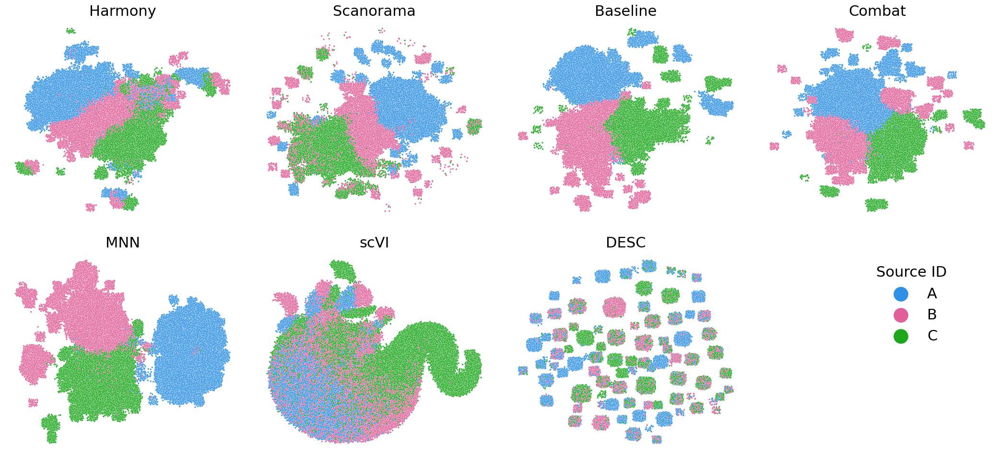

In [17]:
plt.rcParams.update({'font.size': 22})
g = sns.relplot(
    data=embds.sample(frac=1), # Shuffle
    x="x",
    y="y",
    hue="Source",
    hue_order=embds.Source.drop_duplicates().sort_values(),
    kind="scatter",
    col="model",
    col_order=ranker.ranklist,
    s=6,
    col_wrap=4,
    palette=plot.SOURCE_CMAP,
)

#hide axis
g.set(xticks=[], yticks=[])
g.set(xlabel="", ylabel="")
sns.despine(left=True, right=True, top=True, bottom=True)

handles, labels = g.axes[0].get_legend_handles_labels()
g._legend.remove()
leg = g.fig.legend(handles, labels, 
                   title='Source ID', bbox_to_anchor=[0.95, 0.45],
                   frameon=False,
                   markerscale=3.5,
                  )

g.set_titles("{col_name}")
plt.tight_layout()
plt.show()

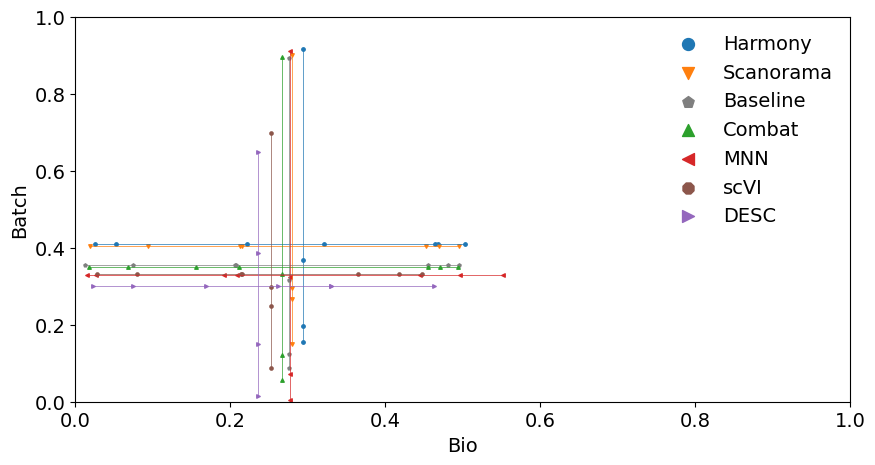

In [18]:
plt.rcParams.update({'font.size': 14})

fig, ax = plt.subplots(figsize=(10,5))
ax.set_xlim([0, 1])
ax.set_ylim([0, 1])

lines = ranker.rank.groupby('model')[['x', 'y']].describe()
lines = lines.loc[ranker.ranklist]
for model, row in lines.iterrows():
    ax.plot([row.x['min'], row.x['max']], [row.y['mean'], row.y['mean']],
            color=plot.METHOD_CMAP[model],
            linewidth=0.5
           )
    ax.plot([row.x['mean'], row.x['mean']], [row.y['min'], row.y['max']],
            color=plot.METHOD_CMAP[model],
            linewidth=0.5
           )
    ax.scatter(
        ranker.rank.query('model==@model').x,
        ranker.rank.query('model==@model').y,
        color=plot.METHOD_CMAP[model],
        marker=plot.METHOD_SMAP[model],
        s=6,
        label=model,
        )
ax.legend(frameon=False, markerscale=3.5,)
ax.set_ylabel('Batch')
ax.set_xlabel('Bio')
plt.show()

## Compounds with > 5 replicates. Top 100 with lowest standard deviation across replicates.

In [19]:
top_k = 16
repl_5 = (
    embds
    .groupby('model', as_index=False)
    ['Compound'].value_counts()
    .groupby('Compound')
    ['count'].min()[lambda x: x>=5].sort_values()
).index

comp_embds = embds[embds.Compound.isin(repl_5)]
cpd_rank = plot.embeddings.label_sort(comp_embds[comp_embds['model']==ranker.ranklist[0]], 'Compound') 

comp_embds = comp_embds[comp_embds['Compound'].isin(cpd_rank[:top_k]) | (~(comp_embds['Compound'].str.startswith('JCP')))]

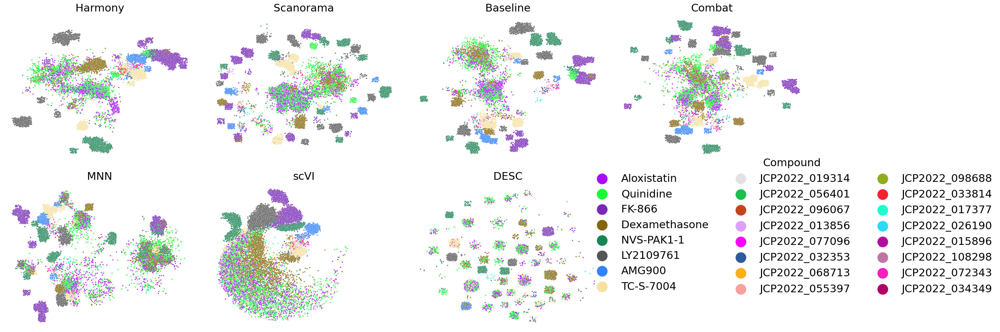

In [20]:
plt.rcParams.update({'font.size': 22})
compounds = comp_embds.Compound.drop_duplicates().tolist()
non_poscons = [c for c in compounds if c not in plot.POSCONS]
poscons = [c for c in compounds if c in plot.POSCONS]
compound_order = poscons + non_poscons[:top_k]

compound_map = dict(zip(non_poscons, itertools.cycle(plot.COMPOUND_COLORS)))
compound_map.update(plot.POSCON_MAP)

g = sns.relplot(
    data=comp_embds.sample(frac=1), # Shuffle
    x="x",
    y="y",
    hue="Compound",
    hue_order=compound_order,
    kind="scatter",
    col="model",
    col_order=ranker.ranklist,
    s=6,
    col_wrap=4,
    palette=compound_map,
)

#hide axis
g.set(xticks=[], yticks=[])
g.set(xlabel="", ylabel="")
sns.despine(left=True, right=True, top=True, bottom=True)

handles, labels = g.axes[0].get_legend_handles_labels()
g._legend.remove()
leg = g.fig.legend(handles, labels,
                   title='Compound', bbox_to_anchor=[1.22, 0.55],
                   frameon=False, ncol=3,
                   markerscale=3.5,
                  )

g.set_titles("{col_name}")
plt.tight_layout()
plt.show()

# Scenario 4

In [21]:
plate_types = ['TARGET2']
sources = ["source_2", "source_3", "source_6",
           "source_8", "source_10"]
output_path = './outputs/scenario_4/'
baseline = 'MAD+Sphering'

all_scores = read_results.load_all_results(output_path)
scores = all_scores[
    all_scores.sources.apply(lambda x: x==sources) &
    all_scores.plate_types.apply(lambda x:x==plate_types) &
    (all_scores.model==baseline) &
    (all_scores.min_replicates_to_eval==5)]

redlist = ['percent_repl', 'PCR_batch', 'wasserstein_distance', 'fraction_positive_p']

rank = plot.param_search.rank_scores(scores, redlist=redlist)
rank_pos = 0
locator = PathLocator(
    config_path=f'{output_path}/{rank.iloc[rank_pos].name}/config.json',
    model = 'sphering',
    min_replicates_to_eval=5,
    output_path=output_path
)

In [22]:
model_scores = read_results.load_same_conf(locator.config_path, 
                                           locator.min_replicates_to_eval,
                                           redlist=redlist,
                                          )

# Ignore PCR_batch for mad+sphering because it is not a fair comparison
redlist_rows = (model_scores['model'] == baseline) & (model_scores['metric'] == 'PCR_batch')
model_scores = model_scores[~redlist_rows]
model_scores.loc[model_scores['model']=='MAD+Sphering', 'model'] = 'Baseline'

# Find metrics with low coefficient of variation
m = model_scores.groupby('metric')['score'].agg(['std', 'mean'])
m['cvar'] = m['std'] / m['mean']
lowcvar_metrics = m.fillna(0).sort_values('cvar')[lambda df: df['cvar']<0.01].index.tolist()

#build Rank
ranker = Ranker(model_scores[~model_scores['metric'].isin(lowcvar_metrics)])

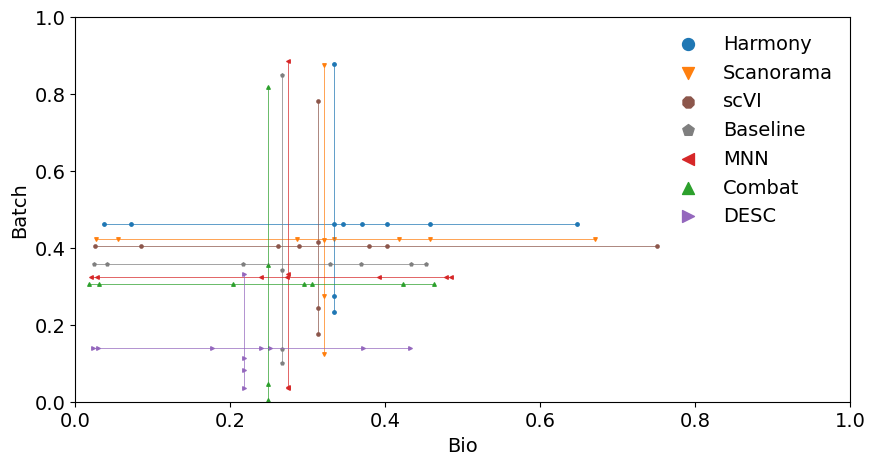

In [23]:
plt.rcParams.update({'font.size': 14})

fig, ax = plt.subplots(figsize=(10,5))
ax.set_xlim([0, 1])
ax.set_ylim([0, 1])

lines = ranker.rank.groupby('model')[['x', 'y']].describe()
lines = lines.loc[ranker.ranklist]
for model, row in lines.iterrows():
    ax.plot([row.x['min'], row.x['max']], [row.y['mean'], row.y['mean']],
            color=plot.METHOD_CMAP[model],
            linewidth=0.5
           )
    ax.plot([row.x['mean'], row.x['mean']], [row.y['min'], row.y['max']],
            color=plot.METHOD_CMAP[model],
            linewidth=0.5
           )
    ax.scatter(
        ranker.rank.query('model==@model').x,
        ranker.rank.query('model==@model').y,
        color=plot.METHOD_CMAP[model],
        marker=plot.METHOD_SMAP[model],
        s=6,
        label=model,
        )
ax.legend(frameon=False, markerscale=3.5,)
ax.set_ylabel('Batch')
ax.set_xlabel('Bio')
plt.show()

In [24]:
embds = []
all_locators = read_results.find_all_locators(output_path)
locators = [loc for loc in all_locators if loc.hashid == locator.hashid]

embds = plot.embeddings.load_embeddings(locators, anon=True)
embds.loc[embds['model']=='MAD+Sphering', 'model'] = 'Baseline'

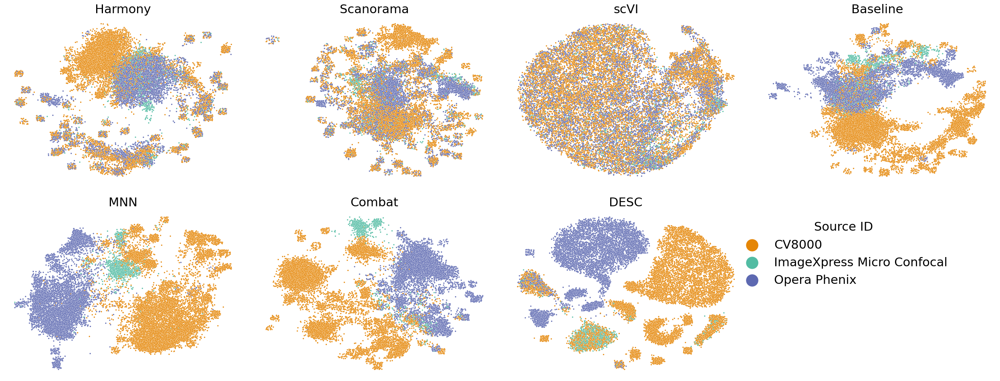

In [25]:
plt.rcParams.update({'font.size': 22})
g = sns.relplot(
    data=embds.sample(frac=1), # Shuffle
    x="x",
    y="y",
    hue="Microscope",
    hue_order=embds.Microscope.drop_duplicates().sort_values(),
    kind="scatter",
    col="model",
    col_order=ranker.ranklist,
    s=6,
    col_wrap=4,
    palette=plot.MICRO_CMAP,
)

#hide axis
g.set(xticks=[], yticks=[])
g.set(xlabel="", ylabel="")
sns.despine(left=True, right=True, top=True, bottom=True)

handles, labels = g.axes[0].get_legend_handles_labels()
g._legend.remove()
leg = g.fig.legend(handles, labels,#, loc='upper center', 
                   title='Source ID', bbox_to_anchor=[0.95, 0.45],
                   frameon=False,
                   markerscale=3.5,
                  )

g.set_titles("{col_name}")
plt.tight_layout()
plt.show()

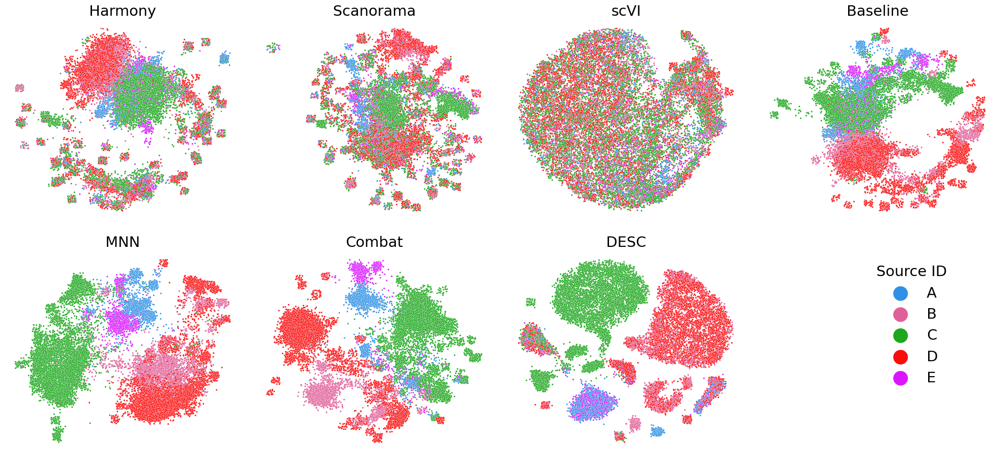

In [26]:
plt.rcParams.update({'font.size': 22})
g = sns.relplot(
    data=embds.sample(frac=1), # Shuffle
    x="x",
    y="y",
    hue="Source",
    hue_order=embds.Source.drop_duplicates().sort_values(),
    kind="scatter",
    col="model",
    col_order=ranker.ranklist,
    s=6,
    col_wrap=4,
    palette=plot.SOURCE_CMAP,
)

#hide axis
g.set(xticks=[], yticks=[])
g.set(xlabel="", ylabel="")
sns.despine(left=True, right=True, top=True, bottom=True)

handles, labels = g.axes[0].get_legend_handles_labels()
g._legend.remove()
leg = g.fig.legend(handles, labels,#, loc='upper center', 
                   title='Source ID', bbox_to_anchor=[0.95, 0.45],
                   frameon=False,
                   markerscale=3.5,
                  )

g.set_titles("{col_name}")
plt.tight_layout()
plt.show()

In [27]:
multiple_pos = embds.groupby('Compound')['Metadata_Well'].nunique()[lambda x: x>1].index
multiple_pos = embds[embds['Compound'].isin(multiple_pos)]

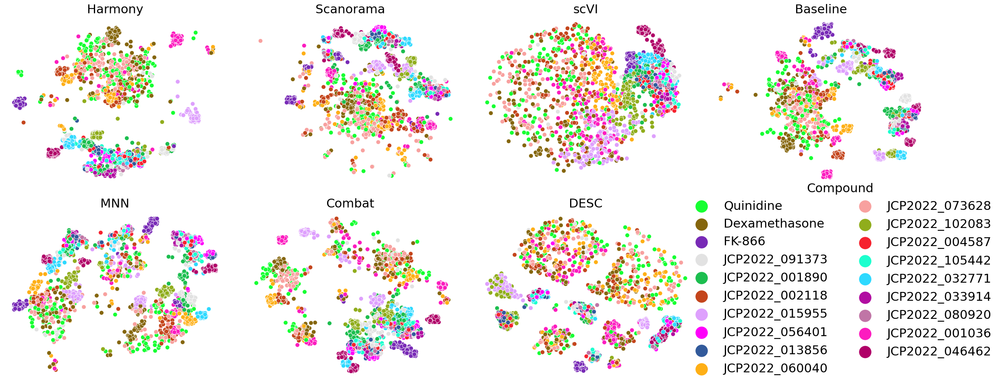

In [28]:
plt.rcParams.update({'font.size': 22})
compounds = multiple_pos.Compound.drop_duplicates().tolist()
non_poscons = [c for c in compounds if c not in plot.POSCONS]
poscons = [c for c in compounds if c in plot.POSCONS]
compound_order = poscons + non_poscons

compound_map = dict(zip(non_poscons, itertools.cycle(plot.COMPOUND_COLORS)))
compound_map.update(plot.POSCON_MAP)
g = sns.relplot(
    data=multiple_pos.sample(frac=1), # Shuffle
    x="x",
    y="y",
    hue="Compound",
    hue_order=compound_order,
    kind="scatter",
    col="model",
    col_order=ranker.ranklist,
    s=60,
    col_wrap=4,
    palette=compound_map,
)

#hide axis
g.set(xticks=[], yticks=[])
g.set(xlabel="", ylabel="")
sns.despine(left=True, right=True, top=True, bottom=True)

handles, labels = g.axes[0].get_legend_handles_labels()
g._legend.remove()
leg = g.fig.legend(handles, labels, ncol=2,
                   title='Compound', bbox_to_anchor=[1.06, 0.55], frameon=False,
                   markerscale=3.5,
                  )

g.set_titles("{col_name}")
plt.tight_layout()
plt.show()

# Scenario 5

In [29]:
plate_types = ['COMPOUND', 'TARGET2']
sources = ["source_2", "source_3", "source_6", "source_8", "source_10"]
output_path = './outputs/scenario_5/'
baseline = 'MAD+Sphering'

all_scores = read_results.load_all_results(output_path)
scores = all_scores[
    all_scores.sources.apply(lambda x: x==sources) &
    all_scores.plate_types.apply(lambda x:x==plate_types) &
    (all_scores.model==baseline) &
    (all_scores.min_replicates_to_eval==5)]

redlist = ['percent_repl', 'PCR_batch', 'wasserstein_distance', 'fraction_positive_p']

rank = plot.param_search.rank_scores(scores, redlist=redlist)
rank_pos = 0
locator = PathLocator(
    config_path=f'{output_path}/{rank.iloc[rank_pos].name}/config.json',
    model = 'sphering',
    min_replicates_to_eval=5,
    output_path=output_path
)

In [30]:
model_scores = read_results.load_same_conf(locator.config_path, 
                                           locator.min_replicates_to_eval,
                                           redlist=redlist,
                                          )

# Ignore PCR_batch for mad+sphering because it is not a fair comparison
redlist_rows = (model_scores['model'] == baseline) & (model_scores['metric'] == 'PCR_batch')
model_scores = model_scores[~redlist_rows]
model_scores.loc[model_scores['model']=='MAD+Sphering', 'model'] = 'Baseline'

# Find metrics with low coefficient of variation
m = model_scores.groupby('metric')['score'].agg(['std', 'mean'])
m['cvar'] = m['std'] / m['mean']
lowcvar_metrics = m.fillna(0).sort_values('cvar')[lambda df: df['cvar']<0.01].index.tolist()

#build Rank
ranker = Ranker(model_scores[~model_scores['metric'].isin(lowcvar_metrics)])

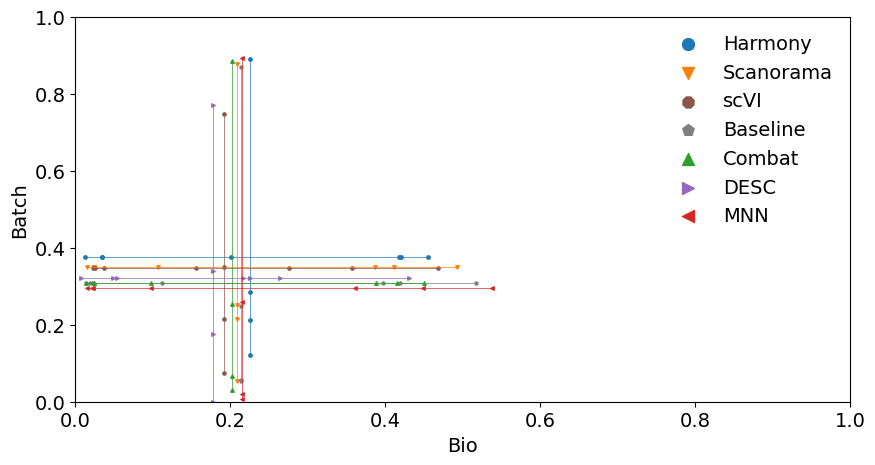

In [31]:
plt.rcParams.update({'font.size': 14})

fig, ax = plt.subplots(figsize=(10,5))
ax.set_xlim([0, 1])
ax.set_ylim([0, 1])

lines = ranker.rank.groupby('model')[['x', 'y']].describe()
lines = lines.loc[ranker.ranklist]
for model, row in lines.iterrows():
    ax.plot([row.x['min'], row.x['max']], [row.y['mean'], row.y['mean']],
            color=plot.METHOD_CMAP[model],
            linewidth=0.5
           )
    ax.plot([row.x['mean'], row.x['mean']], [row.y['min'], row.y['max']],
            color=plot.METHOD_CMAP[model],
            linewidth=0.5
           )
    ax.scatter(
        ranker.rank.query('model==@model').x,
        ranker.rank.query('model==@model').y,
        color=plot.METHOD_CMAP[model],
        marker=plot.METHOD_SMAP[model],
        s=6,
        label=model,
        )
ax.legend(frameon=False, markerscale=3.5,)
ax.set_ylabel('Batch')
ax.set_xlabel('Bio')
plt.show()

In [32]:
embds = []
all_locators = read_results.find_all_locators(output_path)
locators = [loc for loc in all_locators if loc.hashid == locator.hashid]

embds = plot.embeddings.load_embeddings(locators, anon=True)
embds.loc[embds['model']=='MAD+Sphering', 'model'] = 'Baseline'

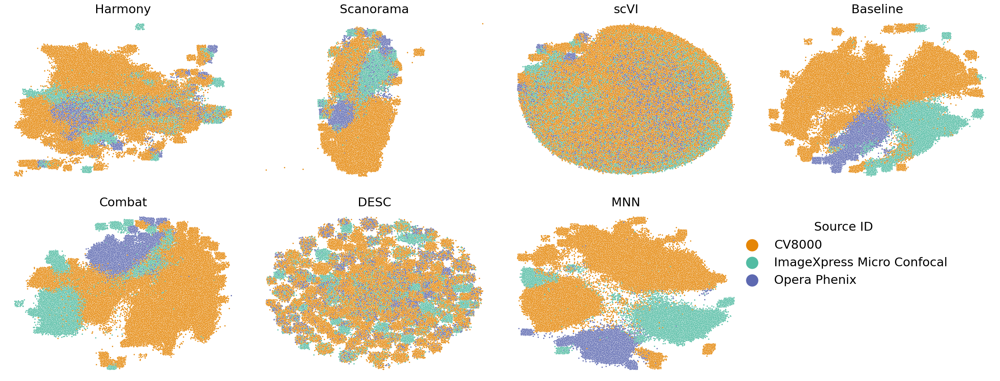

In [33]:
plt.rcParams.update({'font.size': 22})
g = sns.relplot(
    data=embds.sample(frac=1), # Shuffle
    x="x",
    y="y",
    hue="Microscope",
    hue_order=embds.Microscope.drop_duplicates().sort_values(),
    kind="scatter",
    col="model",
    col_order=ranker.ranklist,
    s=6,
    col_wrap=4,
    palette=plot.MICRO_CMAP,
)

#hide axis
g.set(xticks=[], yticks=[])
g.set(xlabel="", ylabel="")
sns.despine(left=True, right=True, top=True, bottom=True)

handles, labels = g.axes[0].get_legend_handles_labels()
g._legend.remove()
leg = g.fig.legend(handles, labels, 
                   title='Source ID', bbox_to_anchor=[0.95, 0.45],
                   frameon=False,
                   markerscale=3.5,
                  )

g.set_titles("{col_name}")
plt.tight_layout()
plt.show()

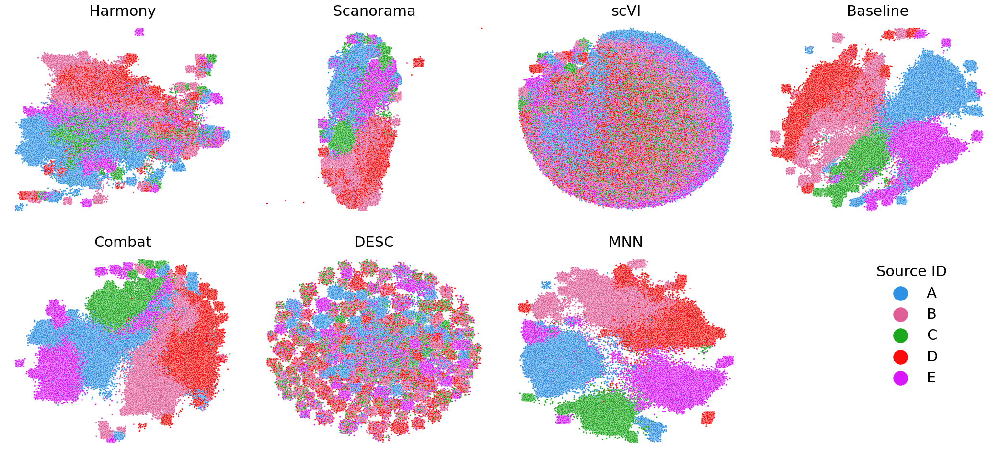

In [34]:
plt.rcParams.update({'font.size': 22})
g = sns.relplot(
    data=embds.sample(frac=1), # Shuffle
    x="x",
    y="y",
    hue="Source",
    hue_order=embds.Source.drop_duplicates().sort_values(),
    kind="scatter",
    col="model",
    col_order=ranker.ranklist,
    s=6,
    col_wrap=4,
    palette=plot.SOURCE_CMAP,
)

#hide axis
g.set(xticks=[], yticks=[])
g.set(xlabel="", ylabel="")
sns.despine(left=True, right=True, top=True, bottom=True)

handles, labels = g.axes[0].get_legend_handles_labels()
g._legend.remove()
leg = g.fig.legend(handles, labels,#, loc='upper center', 
                   title='Source ID', bbox_to_anchor=[0.95, 0.45],
                   frameon=False,
                   markerscale=3.5,
                  )

g.set_titles("{col_name}")
plt.tight_layout()
plt.show()

## Compounds with > 5 replicates. Top 100 with lowest standard deviation across replicates.

In [35]:
top_k = 16
repl_5 = (
    embds
    .groupby('model', as_index=False)
    ['Compound'].value_counts()
    .groupby('Compound')
    ['count'].min()[lambda x: x>=5].sort_values()
).index

comp_embds = embds[embds.Compound.isin(repl_5)]
cpd_rank = plot.embeddings.label_sort(comp_embds[comp_embds['model']==ranker.ranklist[0]], 'Compound') 

comp_embds = comp_embds[comp_embds['Compound'].isin(cpd_rank[:top_k]) | (~(comp_embds['Compound'].str.startswith('JCP')))]

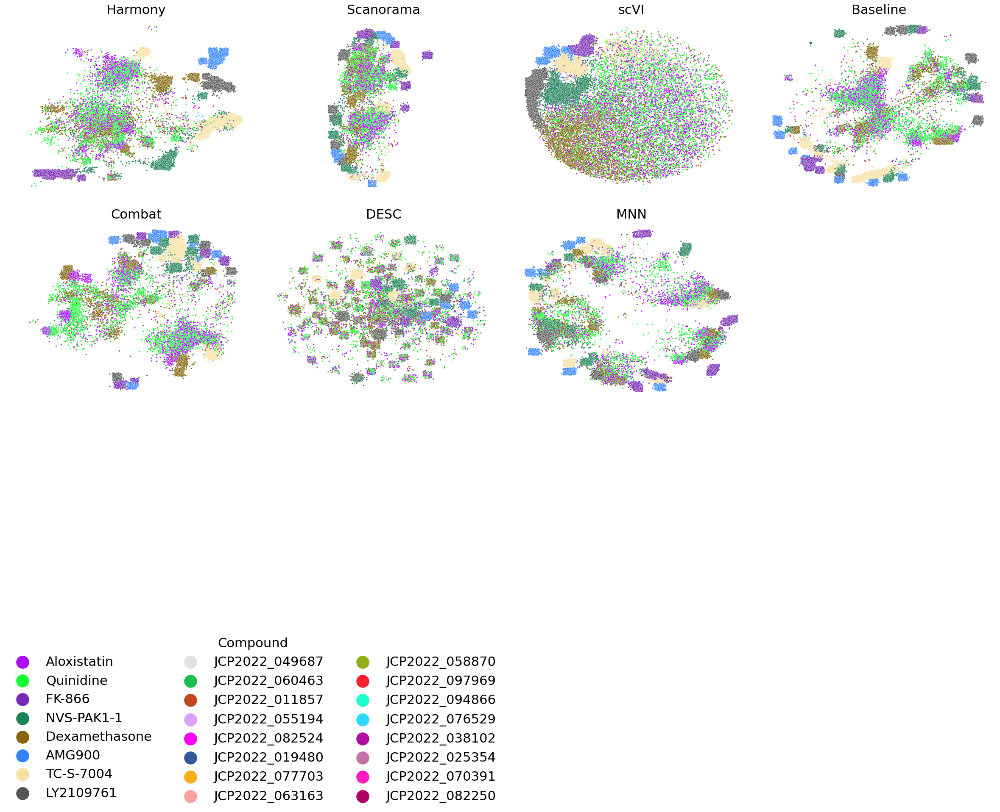

In [36]:
plt.rcParams.update({'font.size': 22})
compounds = comp_embds.Compound.drop_duplicates().tolist()
non_poscons = [c for c in compounds if c not in plot.POSCONS]
poscons = [c for c in compounds if c in plot.POSCONS]
compound_order = poscons + non_poscons[:top_k]

compound_map = dict(zip(non_poscons, itertools.cycle(plot.COMPOUND_COLORS)))
compound_map.update(plot.POSCON_MAP)

g = sns.relplot(
    data=comp_embds.sample(frac=1), # Shuffle
    x="x",
    y="y",
    hue="Compound",
    hue_order=compound_order,
    kind="scatter",
    col="model",
    col_order=ranker.ranklist,
    s=6,
    col_wrap=4,
    palette=compound_map,
)

#hide axis
g.set(xticks=[], yticks=[])
g.set(xlabel="", ylabel="")
sns.despine(left=True, right=True, top=True, bottom=True)

handles, labels = g.axes[0].get_legend_handles_labels()
g._legend.remove()
leg = g.fig.legend(handles, labels,
                   title='Compound', bbox_to_anchor=[0.5, -0.5],
                   frameon=False, ncol=3,
                   markerscale=3.5,
                  )

g.set_titles("{col_name}")
plt.tight_layout()
plt.show()